## ITI Assignment (SentimentAnalysis)for NLP course 
### Mohamed Hatem

# In this project we will predict the sentiment of a given text, And predict if the text is positive, negative or neutral .

### Importing necessary libraries.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.cm as cm # for color maps 
import matplotlib.pyplot as plt 
from matplotlib import rcParams  #for runtime configrattion 
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.cm as cm # for color maps 
import matplotlib.pyplot as plt 
from matplotlib import rcParams  #for runtime configrattion 
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

from sklearn import preprocessing
import re   #for regular expressions
import nltk # Natural Language toolkit
import string # to process python strings 
import contractions
import nlp_utils
import nlp_utils as nu #  contains several functions to analyze text corps
import collections
from collections import Counter # to count how many times a word is repeating
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from wordcloud import WordCloud, STOPWORDS
from nltk.tokenize import word_tokenize,sent_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem import PorterStemmer, LancasterStemmer, SnowballStemmer

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

In [2]:
# reading data. 
Text = pd.read_csv('TextAnalytics.txt')
Text
#so Text contains 999 rows  

,0,"One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.<br /><br />The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.<br /><br />It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.<br /><br />I would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. Forget pretty pictures painted for mainstream audiences, forget charm, forget romance...OZ doesn't mess around. The first episode I ever saw struck me as so nasty it was surreal, I couldn't say I was ready for it, but as I watched more, I developed a taste for Oz, and got accustomed to the high levels of graphic violence. Not just violence, but injustice (crooked guards who'll be sold out for a nickel, inmates who'll kill on order and get away with it, well mannered, middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) Watching Oz, you may become comfortable with what is uncomfortable viewing....thats if you can get in touch with your darker side."
0,1,A wonderful little production. <br /><br />The...
1,2,I thought this was a wonderful way to spend ti...
2,3,Basically there's a family where a little boy ...
3,4,"Petter Mattei's ""Love in the Time of Money"" is..."
4,5,"Probably my all-time favorite movie, a story o..."
...,...,...
994,995,Nothing is sacred. Just ask Ernie Fosselius. T...
995,996,I hated it. I hate self-aware pretentious inan...
996,997,I usually try to be professional and construct...
997,998,If you like me is going to see this in a film ...


In [3]:
# Loading data. 
with open('TextAnalytics.txt','r') as f:
    text = f.read()

In [4]:
text
### The data is in the form of a text.

'0,"One of the other reviewers has mentioned that after watching just 1 Oz episode you\'ll be hooked. They are right, as this is exactly what happened with me.<br /><br />The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.<br /><br />It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.<br /><br />I would say the main appeal of the show is due to th

# Text Normalization

In [5]:
# Separating at new line using '\n' .
text=text.split('\n')

In [6]:
text

['0,"One of the other reviewers has mentioned that after watching just 1 Oz episode you\'ll be hooked. They are right, as this is exactly what happened with me.<br /><br />The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.<br /><br />It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.<br /><br />I would say the main appeal of the show is due to t

In [7]:
# Splitting String by tab(\t)   
corpus = [text]
for sent in text:
    corpus.append(sent.split('\t'))

In [8]:
len(corpus)

1001

In [9]:
# Taking only letters by converting non letters to " "
letters_only = re.sub(r'[^a-zA-Z]', " ",  str(corpus)) 

In [10]:
letters_only

'      One of the other reviewers has mentioned that after watching just   Oz episode you  ll be hooked  They are right  as this is exactly what happened with me  br    br   The first thing that struck me about Oz was its brutality and unflinching scenes of violence  which set in right from the word GO  Trust me  this is not a show for the faint hearted or timid  This show pulls no punches with regards to drugs  sex or violence  Its is hardcore  in the classic use of the word  br    br   It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary  It focuses mainly on Emerald City  an experimental section of the prison where all the cells have glass fronts and face inwards  so privacy is not high on the agenda  Em City is home to many  Aryans  Muslims  gangstas  Latinos  Christians  Italians  Irish and more    so scuffles  death stares  dodgy dealings and shady agreements are never far away  br    br   I would say the main appeal of the show is due to

### Tokenization

In [11]:
# converting to lowercase.
letters_only=letters_only.lower()

token=nltk.sent_tokenize(letters_only)
token

['      one of the other reviewers has mentioned that after watching just   oz episode you  ll be hooked  they are right  as this is exactly what happened with me  br    br   the first thing that struck me about oz was its brutality and unflinching scenes of violence  which set in right from the word go  trust me  this is not a show for the faint hearted or timid  this show pulls no punches with regards to drugs  sex or violence  its is hardcore  in the classic use of the word  br    br   it is called oz as that is the nickname given to the oswald maximum security state penitentary  it focuses mainly on emerald city  an experimental section of the prison where all the cells have glass fronts and face inwards  so privacy is not high on the agenda  em city is home to many  aryans  muslims  gangstas  latinos  christians  italians  irish and more    so scuffles  death stares  dodgy dealings and shady agreements are never far away  br    br   i would say the main appeal of the show is due t

### Alphanumeric characters

In [12]:
def num_dec_al(word):
    if word.isnumeric():
        return 'xxxxxx'
    elif word.isdecimal():
        return 'xxx...'
    elif word.isalpha():
        return word
    else:
        return 'xxxaaa'

def clean(token):
    tokens = nlp_utils.w_tokenization(token)
    map_list = list(map(num_dec_al,tokens))
    return " ".join(map_list)

corpus = list(map(clean,token))

corpus
### Alpha numeric characters and decimals have been replaced with characters

['one of the other reviewers has mentioned that after watching just oz episode you ll be hooked they are right as this is exactly what happened with me br br the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go trust me this is not a show for the faint hearted or timid this show pulls no punches with regards to drugs sex or violence its is hardcore in the classic use of the word br br it is called oz as that is the nickname given to the oswald maximum security state penitentary it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda em city is home to many aryans muslims gangstas latinos christians italians irish and more so scuffles death stares dodgy dealings and shady agreements are never far away br br i would say the main appeal of the show is due to the fact that it goes where other shows wouldn t d

### Removing Contractions.
dropping apostrophe and replacing them by letters 

isn't --> is not, 

I'm --> I am, 

In [13]:
conm = contractions.CONTRACTION_MAP
def contraction_remove(corpus):
    for key,value in conm.items():
        corpus = re.sub(r"{}".format(key),'{}'.format(value),corpusa)
        
    return corpus

special = string.punctuation
def w_tokenization(corpus):
    # convert into lower case
    corpus = corpus.lower()
    # contraction
    corpus = contraction_remove(corpus)
    # 
    tokens = nltk.word_tokenize(corpus) # word tokens
## contractions have been expanded and the letters have been converted to lowercase.    

In [14]:
corpus
## corpus with expanded contractions and converted to lowercase.    

['one of the other reviewers has mentioned that after watching just oz episode you ll be hooked they are right as this is exactly what happened with me br br the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go trust me this is not a show for the faint hearted or timid this show pulls no punches with regards to drugs sex or violence its is hardcore in the classic use of the word br br it is called oz as that is the nickname given to the oswald maximum security state penitentary it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda em city is home to many aryans muslims gangstas latinos christians italians irish and more so scuffles death stares dodgy dealings and shady agreements are never far away br br i would say the main appeal of the show is due to the fact that it goes where other shows wouldn t d

In [15]:
data = [corpus]
for sent in text:
    data.append(sent.split('\t'))
# Separating at tab     

In [16]:
data.append(sent.split('\n'))
# Separating at newline

In [17]:
data
# Cleaned text

[['one of the other reviewers has mentioned that after watching just oz episode you ll be hooked they are right as this is exactly what happened with me br br the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go trust me this is not a show for the faint hearted or timid this show pulls no punches with regards to drugs sex or violence its is hardcore in the classic use of the word br br it is called oz as that is the nickname given to the oswald maximum security state penitentary it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda em city is home to many aryans muslims gangstas latinos christians italians irish and more so scuffles death stares dodgy dealings and shady agreements are never far away br br i would say the main appeal of the show is due to the fact that it goes where other shows wouldn t 

In [18]:
# dropping unnecessary columns.
df = pd.DataFrame(data)

In [19]:
df

,0,1,2,3,4,5,6
0,one of the other reviewers has mentioned that ...,None,None,None,None,None,None
1,"0,""One of the other reviewers has mentioned th...",None,None,None,None,None,None
2,"1,""A wonderful little production. <br /><br />...",None,None,None,None,None,None
3,"2,""I thought this was a wonderful way to spend...",None,None,None,None,None,None
4,"3,""Basically there's a family where a little b...",None,None,None,None,None,None
...,...,...,...,...,...,...,...
997,"996,""I hated it. I hate self-aware pretentious...",None,None,None,None,None,None
998,"997,""I usually try to be professional and cons...",None,None,None,None,None,None
999,"998,""If you like me is going to see this in a ...",None,None,None,None,None,None
1000,"999,""This is like a zoology textbook, given th...",None,None,None,None,None,None


In [20]:
df.drop([1,2,3,4,5,6],axis=1,inplace=True)


In [21]:
df

,0
0,one of the other reviewers has mentioned that ...
1,"0,""One of the other reviewers has mentioned th..."
2,"1,""A wonderful little production. <br /><br />..."
3,"2,""I thought this was a wonderful way to spend..."
4,"3,""Basically there's a family where a little b..."
...,...
997,"996,""I hated it. I hate self-aware pretentious..."
998,"997,""I usually try to be professional and cons..."
999,"998,""If you like me is going to see this in a ..."
1000,"999,""This is like a zoology textbook, given th..."


In [22]:
df= df.rename(columns={0: 'Text'})
# Renaming the column 0 as 'Text'

#### Final Dataset.

In [23]:
df

,Text
0,one of the other reviewers has mentioned that ...
1,"0,""One of the other reviewers has mentioned th..."
2,"1,""A wonderful little production. <br /><br />..."
3,"2,""I thought this was a wonderful way to spend..."
4,"3,""Basically there's a family where a little b..."
...,...
997,"996,""I hated it. I hate self-aware pretentious..."
998,"997,""I usually try to be professional and cons..."
999,"998,""If you like me is going to see this in a ..."
1000,"999,""This is like a zoology textbook, given th..."


### Rows 0,1 and 1000 and 1001 needs to be cleaned.

In [24]:
df.drop(df.index[:1], inplace=True)
# row 1 has repeated so it is dropped.

In [25]:
df.drop(df.index[1000:], inplace=True)
# row 1000 has repeated aswell, so it is dropped.

In [26]:
df

,Text
1,"0,""One of the other reviewers has mentioned th..."
2,"1,""A wonderful little production. <br /><br />..."
3,"2,""I thought this was a wonderful way to spend..."
4,"3,""Basically there's a family where a little b..."
5,"4,""Petter Mattei's """"Love in the Time of Money..."
...,...
996,"995,""Nothing is sacred. Just ask Ernie Fosseli..."
997,"996,""I hated it. I hate self-aware pretentious..."
998,"997,""I usually try to be professional and cons..."
999,"998,""If you like me is going to see this in a ..."


In [102]:
df.Text.iloc[0]

'one of the other reviewer have mention that after watch just oz episode youll be hook they be right a this be exactly what happen with me.the first thing that strike me about oz be it utality and unflinching scene of violence which set in right from the word go trust me this be not a show for the faint hearted or timid this show pull no punch with regard to drug sex or violence it be hardcore in the classic use of the word.it be call oz a that be the nickname give to the oswald maximum security state penitentary it focus mainly on emerald city an experimental section of the prison where all the cell have glass front and face inwards so privacy be not high on the agenda em city be home to many .. aryan muslim gangstas latinos christian italian irish and more .... so scuffles death stare dodgy dealing and shady agreement be never far away.i would say the main appeal of the show be due to the fact that it go where other show wouldnt dare forget pretty picture paint for mainstream audienc

### Removing additional characters present in the dataframe.

In [27]:
## We can see that there are still some special characters in the dataframe which have to be cleaned.
df.replace('\d+', '', regex=True, inplace=True)
df.replace(',', '', regex=True, inplace=True)
df.replace('br', '', regex=True, inplace=True)
df.replace('"', '', regex=True, inplace=True)
df.replace("'", '', regex=True, inplace=True)
df.replace('?', '', inplace=True)
df.replace("-", '', regex=True, inplace=True)
df.replace("*", '', inplace=True)
df.replace("***", '', inplace=True)
df.replace("< />", '', regex=True, inplace=True)

In [28]:
df['Text'] = df['Text'].str.strip('[')
df['Text'] = df['Text'].str.strip(']')
df['Text'] = df['Text'].str.strip(')')
df['Text'] = df['Text'].str.strip('(')
## Using the strip function in order to delete the special characters.

In [29]:
df

,Text
1,One of the other reviewers has mentioned that ...
2,A wonderful little production. The filming tec...
3,I thought this was a wonderful way to spend ti...
4,Basically theres a family where a little boy (...
5,Petter Matteis Love in the Time of Money is a ...
...,...
996,Nothing is sacred. Just ask Ernie Fosselius. T...
997,I hated it. I hate selfaware pretentious inani...
998,I usually try to be professional and construct...
999,If you like me is going to see this in a film ...


## Lemmatization of the text column

In [ ]:
 #return the base or dictionary form of a word, Lemmatization will also generates the root form of the words

In [30]:
df['Text'] = df['Text'].apply(nu.lemmatization_sentence)

In [31]:
Text=df['Text']

In [33]:
token=Text.to_numpy()

In [34]:
token=nltk.sent_tokenize(str(token))
## Sentence tokenization

In [35]:
data = np.array(token)
## Saving token in form of array

In [36]:
stop = stopwords.words('english')
## Saving stopwords in stop

### Removing stopwords from the dataframe

In [37]:
text = data
text_tokens = word_tokenize(str(text))

tokens_without_sw = [word for word in text_tokens if not word in stop]

print(tokens_without_sw)   
## Removing stopwords from the text and printing the words without stopwords

['[', '``', '[', "'one", 'reviewer', 'mention', 'watch', 'oz', 'episode', 'youll', 'hook', 'right', 'exactly', 'happen', 'me.the', 'first', 'thing', 'strike', 'oz', 'utality', 'unflinching', 'scene', 'violence', 'set', 'right', 'word', 'go', 'trust', 'show', 'faint', 'hearted', 'timid', 'show', 'pull', 'punch', 'regard', 'drug', 'sex', 'violence', 'hardcore', 'classic', 'use', 'word.it', 'call', 'oz', 'nickname', 'give', 'oswald', 'maximum', 'security', 'state', 'penitentary', 'focus', 'mainly', 'emerald', 'city', 'experimental', 'section', 'prison', 'cell', 'glass', 'front', 'face', 'inwards', 'privacy', 'high', 'agenda', 'em', 'city', 'home', 'many', '..', 'aryan', 'muslim', 'gangstas', 'latinos', 'christian', 'italian', 'irish', '....', 'scuffles', 'death', 'stare', 'dodgy', 'dealing', 'shady', 'agreement', 'never', 'far', 'away.i', 'would', 'say', 'main', 'appeal', 'show', 'due', 'fact', 'go', 'show', 'wouldnt', 'dare', 'forget', 'pretty', 'picture', 'paint', 'mainstream', 'audienc

# Visualization

In [38]:
stopwords = set(stopwords.words("english"))
## Removing stopwords for wordcloud visualization

In [39]:
wordcloud = WordCloud(stopwords=stop, background_color="white", max_words=1000).generate(str(tokens_without_sw))
## WordCloud is a technique to show which words are the most frequent among the given text

### Visualizing the highest repeating words in the dataframe using  the wordcloud.

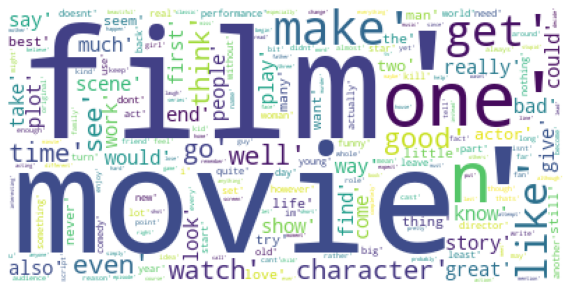

In [90]:
rcParams['figure.figsize'] = 10, 20
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

### Counting the number of times a word has repeated through out the data.

In [41]:
tokens_without_sw=(str(tokens_without_sw))

In [95]:
filtered_words = [word for word in tokens_without_sw.split() if word not in stopwords]
counted_words = collections.Counter(filtered_words) # for counting words
# print(counted_words)  #  A dictionary contains every word and its frequency
# print(counted_words.most_common(10))
words = []
counts = []
for letter, count in counted_words.most_common(10):
    words.append(letter)
    counts.append(count)
# Removing stopwords and creating two lists to display the words and their counts    

[("'movie',", 2019), ("'film',", 1773), ("'one',", 980), ("'make',", 888), ("'see',", 856), ("'like',", 828), ("'get',", 751), ("'good',", 644), ("'go',", 542), ("'watch',", 541)]


In [43]:
counted_words.most_common(100) # the word 'movie' has repeated for 2081 times.

[("'movie',", 2019),
 ("'film',", 1773),
 ("'one',", 980),
 ("'make',", 888),
 ("'see',", 856),
 ("'like',", 828),
 ("'get',", 751),
 ("'good',", 644),
 ("'go',", 542),
 ("'watch',", 541),
 ("'time',", 533),
 ("'character',", 524),
 ("'even',", 510),
 ("'would',", 490),
 ("'bad',", 489),
 ("'think',", 471),
 ("'story',", 468),
 ("'really',", 452),
 ("'well',", 445),
 ("'scene',", 434),
 ("'much',", 392),
 ("'show',", 375),
 ("'great',", 375),
 ("'know',", 368),
 ("'take',", 361),
 ("'look',", 360),
 ("'people',", 356),
 ("'way',", 353),
 ("'give',", 349),
 ("'...',", 342),
 ("'say',", 336),
 ("'also',", 336),
 ("'come',", 333),
 ("'play',", 332),
 ("'first',", 325),
 ("'end',", 322),
 ("'find',", 309),
 ("'dont',", 309),
 ("'thing',", 299),
 ("'plot',", 297),
 ("'want',", 293),
 ("'many',", 283),
 ("'love',", 281),
 ("'work',", 275),
 ("'life',", 273),
 ("'never',", 272),
 ("'little',", 270),
 ("'seem',", 270),
 ("'could',", 269),
 ("'two',", 265),
 ("'actor',", 263),
 ("'best',", 258)

# Visualizing top 10 common words using bar graph.

😀


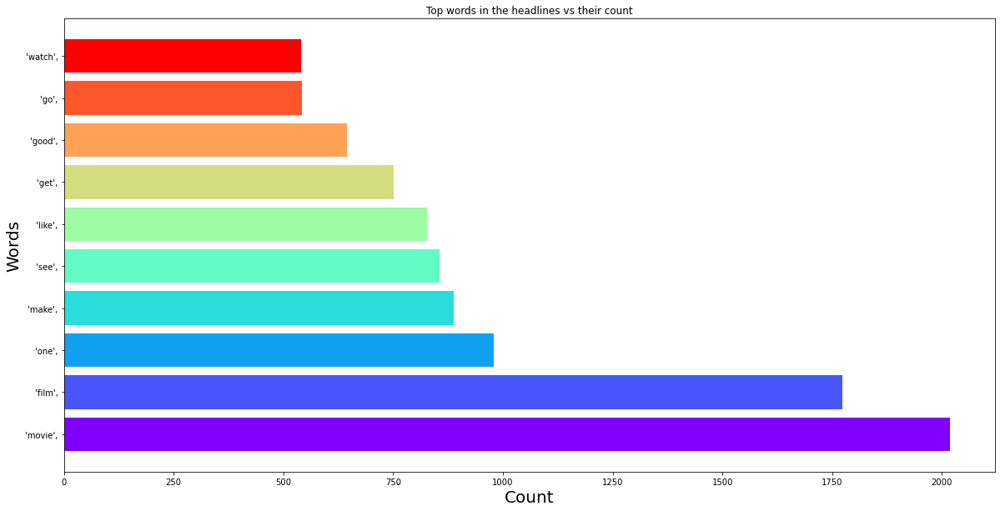

In [104]:
colors = cm.rainbow(np.linspace(0, 1, 10))
rcParams['figure.figsize'] = 20, 10

plt.title('Top words in the headlines vs their count')
# plt.xticks(fontsize=20 )
# plt.yticks(fontsize=10 )
plt.xlabel('Count',fontsize=20)
plt.ylabel('Words',fontsize=20)
plt.barh(words, counts, color=colors)
# It looks like rainbow flag :)
print("\U0001F600")

# Sentiment Analysis(Vader sentiment analysis):

### Vader sentiment analysis is done in order to find if a given (Word) is positive, negative 

In [105]:
#positive words have higher positive ratings and more negative words have lower negative ratings.
# for more information visit this link "https://towardsdatascience.com/sentimental-analysis-using-vader-a3415fef7664"

In [103]:
# import nltk
# nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Mohamed Hatem\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [45]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
sentence = tokens_without_sw
tokenized_sentence = nltk.word_tokenize(sentence)

sid = SentimentIntensityAnalyzer()
pos_word_list=[]
neu_word_list=[]
neg_word_list=[]

for word in tokenized_sentence:
    if (sid.polarity_scores(word)['compound']) >= 0.1: # compound is taking considration of positve,negative and neutral
        pos_word_list.append(word)
    elif (sid.polarity_scores(word)['compound']) <= -0.1:
        neg_word_list.append(word)
    else:        
        neu_word_list.append(word)                

print('Positive:',pos_word_list)        
print('Neutral:',neu_word_list)    
print('Negative:',neg_word_list) 
score = sid.polarity_scores(sentence)
print('\nScores:', score)

Positive: ["'trust", "'security", "'agreement", "'pretty", "'charm", "'romance", "'ready", "'well", "'comfortable", "'wonderful", "'comforting", "'well", "'truly", "'well", "'worth", "'great", "'comedy", "'dream", "'solid", "'play", "'well", "'wonderful", "'lighthearted", "'comedy", "'well", "'laugh", "'comedy", "'impress", "'sexy", "'spirited", "'jewel", "'interesting", "'great", "'comedy", "'thriller", "'like", "'thriller", "'well", "'play", "'love", "'stunning", "'success", "'play", "'sophisticated", "'best", "'sincere", "'good", "'talented", "'wish", "'good", "'luck", "'await", "'favorite", "'noble", "'truly", "'sympathetic", "'delight", "'like", "'fun", "'sure", "'like", "'excitement", "'heros", "'thank", "'like", "'nice", "'amazing", "'fresh", "'innovative", "'funny", "'truly", "'entertaining", "'original", "'fit", "'respect", "'original", "'huge", "'success", "'encourage", "'positive", "'truly", "'play", "'happy", "'credit", "'best", "'like", "'original", "'laughter", "'like", "


Scores: {'neg': 0.176, 'neu': 0.574, 'pos': 0.25, 'compound': 1.0}


In [108]:
tokenized_sentence

['[',
 "'",
 '[',
 "'",
 ',',
 "'",
 '``',
 "'",
 ',',
 "'",
 '[',
 "'",
 ',',
 '``',
 "'one",
 "''",
 ',',
 "'reviewer",
 "'",
 ',',
 "'mention",
 "'",
 ',',
 "'watch",
 "'",
 ',',
 "'oz",
 "'",
 ',',
 "'episode",
 "'",
 ',',
 "'youll",
 "'",
 ',',
 "'hook",
 "'",
 ',',
 "'right",
 "'",
 ',',
 "'exactly",
 "'",
 ',',
 "'happen",
 "'",
 ',',
 "'me.the",
 "'",
 ',',
 "'first",
 "'",
 ',',
 "'thing",
 "'",
 ',',
 "'strike",
 "'",
 ',',
 "'oz",
 "'",
 ',',
 "'utality",
 "'",
 ',',
 "'unflinching",
 "'",
 ',',
 "'scene",
 "'",
 ',',
 "'violence",
 "'",
 ',',
 "'set",
 "'",
 ',',
 "'right",
 "'",
 ',',
 "'word",
 "'",
 ',',
 "'go",
 "'",
 ',',
 "'trust",
 "'",
 ',',
 "'show",
 "'",
 ',',
 "'faint",
 "'",
 ',',
 "'hearted",
 "'",
 ',',
 "'timid",
 "'",
 ',',
 "'show",
 "'",
 ',',
 "'pull",
 "'",
 ',',
 "'punch",
 "'",
 ',',
 "'regard",
 "'",
 ',',
 "'drug",
 "'",
 ',',
 "'sex",
 "'",
 ',',
 "'violence",
 "'",
 ',',
 "'hardcore",
 "'",
 ',',
 "'classic",
 "'",
 ',',
 "'use",
 "'",
 ',',
 "'wo

In [83]:
pos_word_list[:100]


["'trust",
 "'security",
 "'agreement",
 "'pretty",
 "'charm",
 "'romance",
 "'ready",
 "'well",
 "'comfortable",
 "'wonderful",
 "'comforting",
 "'well",
 "'truly",
 "'well",
 "'worth",
 "'great",
 "'comedy",
 "'dream",
 "'solid",
 "'play",
 "'well",
 "'wonderful",
 "'lighthearted",
 "'comedy",
 "'well",
 "'laugh",
 "'comedy",
 "'impress",
 "'sexy",
 "'spirited",
 "'jewel",
 "'interesting",
 "'great",
 "'comedy",
 "'thriller",
 "'like",
 "'thriller",
 "'well",
 "'play",
 "'love",
 "'stunning",
 "'success",
 "'play",
 "'sophisticated",
 "'best",
 "'sincere",
 "'good",
 "'talented",
 "'wish",
 "'good",
 "'luck",
 "'await",
 "'favorite",
 "'noble",
 "'truly",
 "'sympathetic",
 "'delight",
 "'like",
 "'fun",
 "'sure",
 "'like",
 "'excitement",
 "'heros",
 "'thank",
 "'like",
 "'nice",
 "'amazing",
 "'fresh",
 "'innovative",
 "'funny",
 "'truly",
 "'entertaining",
 "'original",
 "'fit",
 "'respect",
 "'original",
 "'huge",
 "'success",
 "'encourage",
 "'positive",
 "'truly",
 "'play",
 "'h

In [84]:
neg_word_list[:100]

["'strike",
 "'violence",
 "'timid",
 "'violence",
 "'prison",
 "'death",
 "'dodgy",
 "'forget",
 "'forget",
 "'forget",
 "'mess",
 "'strike",
 "'nasty",
 "'violence",
 "'violence",
 "'injustice",
 "'kill",
 "'prison",
 "'bitch",
 "'lack",
 "'prison",
 "'uncomfortable",
 "'discomforting",
 "'disappear",
 "'terribly",
 "'suspect",
 "'killer",
 "'disappoint",
 "'risk",
 "'devil",
 "'fight",
 "'kill",
 "'argue",
 "'ruin",
 "'meaningless",
 "'ignore",
 "'loneliness",
 "'anxiously",
 "'bore",
 "'startle",
 "'doubt",
 "'drop",
 "'waste",
 "'painfully",
 "'bad",
 "'bad",
 "'hard",
 "'awful",
 "'bad",
 "'mistake",
 "'bad",
 "'awful",
 "'lame",
 "'nasty",
 "'bore",
 "'obsessive",
 "'hell",
 "'odd",
 "'low",
 "'problem",
 "'lose",
 "'scary",
 "'helplessly",
 "'horror",
 "'die",
 "'scary",
 "'cry",
 "'kill",
 "'warn",
 "'cry",
 "'complain",
 "'evil",
 "'mad",
 "'cry",
 "'disappoint",
 "'fight",
 "'cry",
 "'reek",
 "'annoying",
 "'shoot",
 "'ruin",
 "'cut",
 "'prisoner",
 "'bad",
 "'sorrow",
 "'bi

### Top 100 Positive words.

In [47]:
print(list(pos_word_list[:100])) # These are the top 100 positive words in the dataset.

["'trust", "'security", "'agreement", "'pretty", "'charm", "'romance", "'ready", "'well", "'comfortable", "'wonderful", "'comforting", "'well", "'truly", "'well", "'worth", "'great", "'comedy", "'dream", "'solid", "'play", "'well", "'wonderful", "'lighthearted", "'comedy", "'well", "'laugh", "'comedy", "'impress", "'sexy", "'spirited", "'jewel", "'interesting", "'great", "'comedy", "'thriller", "'like", "'thriller", "'well", "'play", "'love", "'stunning", "'success", "'play", "'sophisticated", "'best", "'sincere", "'good", "'talented", "'wish", "'good", "'luck", "'await", "'favorite", "'noble", "'truly", "'sympathetic", "'delight", "'like", "'fun", "'sure", "'like", "'excitement", "'heros", "'thank", "'like", "'nice", "'amazing", "'fresh", "'innovative", "'funny", "'truly", "'entertaining", "'original", "'fit", "'respect", "'original", "'huge", "'success", "'encourage", "'positive", "'truly", "'play", "'happy", "'credit", "'best", "'like", "'original", "'laughter", "'like", "'love", "'

### Top 100 Negative words.

In [48]:
print(list(neg_word_list[:100])) # These are the top 100 negative words in the dataset.

["'strike", "'violence", "'timid", "'violence", "'prison", "'death", "'dodgy", "'forget", "'forget", "'forget", "'mess", "'strike", "'nasty", "'violence", "'violence", "'injustice", "'kill", "'prison", "'bitch", "'lack", "'prison", "'uncomfortable", "'discomforting", "'disappear", "'terribly", "'suspect", "'killer", "'disappoint", "'risk", "'devil", "'fight", "'kill", "'argue", "'ruin", "'meaningless", "'ignore", "'loneliness", "'anxiously", "'bore", "'startle", "'doubt", "'drop", "'waste", "'painfully", "'bad", "'bad", "'hard", "'awful", "'bad", "'mistake", "'bad", "'awful", "'lame", "'nasty", "'bore", "'obsessive", "'hell", "'odd", "'low", "'problem", "'lose", "'scary", "'helplessly", "'horror", "'die", "'scary", "'cry", "'kill", "'warn", "'cry", "'complain", "'evil", "'mad", "'cry", "'disappoint", "'fight", "'cry", "'reek", "'annoying", "'shoot", "'ruin", "'cut", "'prisoner", "'bad", "'sorrow", "'bizarre", "'hard", "'ridiculous", "'nonsense", "'stereotyped", "'bad", "'waste", "'star

## Vader sentiment analysis for a given Sentence if positive, negative or  neutral .

In [49]:
sid = SentimentIntensityAnalyzer()
for sentence in Text:
     print(sentence)
        
     ss = sid.polarity_scores(sentence)
     for k in ss:
         print('{0}: {1}, ' .format(k, ss[k]), end='')
     print()

one of the other reviewer have mention that after watch just oz episode youll be hook they be right a this be exactly what happen with me.the first thing that strike me about oz be it utality and unflinching scene of violence which set in right from the word go trust me this be not a show for the faint hearted or timid this show pull no punch with regard to drug sex or violence it be hardcore in the classic use of the word.it be call oz a that be the nickname give to the oswald maximum security state penitentary it focus mainly on emerald city an experimental section of the prison where all the cell have glass front and face inwards so privacy be not high on the agenda em city be home to many .. aryan muslim gangstas latinos christian italian irish and more .... so scuffles death stare dodgy dealing and shady agreement be never far away.i would say the main appeal of the show be due to the fact that it go where other show wouldnt dare forget pretty picture paint for mainstream audience

neg: 0.124, neu: 0.8, pos: 0.076, compound: -0.7938, 
the karen carpenter story show a little more about singer karen carpenter complex life though it fail in give accurate fact and details.cynthia gibb portrays karen be not a fine election she be a good actress but play a very naive and sort of dumb karen carpenter i think that the role need a strong character someone with a strong personality.louise fletcher role a agnes carpenter be terrific she do a great job a karen mother.it have great song which could have be include in a soundtrack album unfortunately they werent though this movie be on the top of the rating in usa and other several country
neg: 0.104, neu: 0.67, pos: 0.225, compound: 0.9637, 
the cell be an exotic masterpiece a dizzying trip into not only the vast mind of a serial killer but also into one of a very talented director this be conclusive evidence of what can be achieve if human being unleash their uninhibited imagination this be boldness at work push aside though

neg: 0.144, neu: 0.767, pos: 0.089, compound: -0.9799, 
the plot be about the death of little child hopper be the one who have to investigate the killing during the movie it appear that he have some trouble with his daughter in the end the serial killer get catch thats it but before you find out who dunnit you have to see some terrible acting by all of the actor it be unbelievable how bad these actor be include hopper i could go on like this but that to much of a waste of my time just dont watch the movie ive warn you
neg: 0.209, neu: 0.744, pos: 0.048, compound: -0.9545, 
ever watch a movie that lose the plot well this didnt even really have one to begin with.where to begin the achingly tedious scene of our heroine sit around the house with actually no sense of menace or even forebode create even during the apparently constant thunderstorm that be strangely never actually hear in the housegreat double glaze the house that be apparently only a few mile from a town yet be several hour w

neg: 0.023, neu: 0.867, pos: 0.11, compound: 0.9032, 
a a disclaimer ive see the movie time in the last year and i only just saw the musical this week this allow me to judge the movie without be taint by what be or wasnt in the musical however it taint me when i watch the musical i actually believe michael douglas work quite well in that role along with kasey i think her let me dance for you scene be one of the best part of the movie a worthwhile addition compare to the musical the dancer and sing in the movie be much superior to the musical as well a the cast which be at least time big easy to do in the movie of course the decor light dancing and singing be also much superior in the movie which should be expect and be indeed deliver the song that be in common with the musical be well do in the movie the new one be quite good one and the whole movie just deliver more than the musical in my opinion especially compare to a musical which have few decor the one bad point on the movie be th

neg: 0.104, neu: 0.73, pos: 0.166, compound: 0.9929, 
bela lugosi appear in several of these low budget chiller for monogram studio in the s and the corpse vanishes be one of the good ones.bela play a mad scientist who kidnap young ides and kill them and then extract fluid from their body so he can keep his age wife look young after a reporter and a doctor stay the night at his home and discover he be responsible for the ides deaths the follow morning they report these murder to the police and the mad scientist be shot and drop dead shortly afterwards.you have get almost everything in this movie the scientist assistant consist of an old hag a hunchback and dwarf her son a thunderstorm and spooky passage in belas house bela and his wife find they sleep well in coffin rather than bed in the movie.the corpse vanishes be worth a look especially for bela lugosi fan great fun.rating star out of
neg: 0.167, neu: 0.738, pos: 0.095, compound: -0.9493, 
i can not believe i enjoy this as much a i

neg: 0.115, neu: 0.793, pos: 0.092, compound: -0.8617, 
maybe it be the title or the trailer certainly not the interview on the dvd which be with the director a he keep say hi kid into the camera like a buffoon but i have expectation for entrails of a virgin to be at least a bit of sleazy fun with some good sex scene and utal bloody killing by a weird japanese penetrator turn out it way too sleazy for it own good or bad or whatever theres a problem and one can see this also in the italian sexploitation flick porno holocaust similar to this in many respect in not have balance to the sex and violence too much sex and it will turn into a prototypical porno and not even with much production quality in comparison with most professional porno movie and with the kill scene there have to be at least a little tack and maybe just a smidgen of ingenuity in create the creature/killer/whatever entrails of a virgin have neither it safe to say it a pretty soulless movie even if isnt one of the very b

neg: 0.024, neu: 0.815, pos: 0.161, compound: 0.996, 
if anyone be wonder why no one make movie like they use to with conversation character and a simple theme of friendship struggle to evolve into something new good and different those folk need to take in this film and see top notch write directing and act that meld into a wonderful evening of observation on how thing use to be in italy and england other day other time funnel into a terrific comedy of entertainment make in with alfred molina joan plowright polly walker josie lawrence jim broadbent miranda richardson and michael kitchen in the major role under the ush stroke direction of mike newell these actor accomplish vividly memorable performance that be photograph with a sublimely subtle painter eye reminiscent of the theatrical bedroom farce of the turn of the century this film might be call a friendship farce that become a worthwhile experience in the growth of the romantic nature within each character and the viewer too an ar

neg: 0.187, neu: 0.703, pos: 0.11, compound: -0.8472, 
i greatly enjoy margaret atwoods novel the robber bride and i be thrill to see there be a movie version a woman frame a cop boyfriend for her own murder and his buddy an excop journalist try to clear his name by check up on the dead woman crazy female friends it fortunate that the movie script fix ms. atwoods clumsy plot by focus on the story of these two men victim of scheme woman ... heh okay you get me if these guy be mention in the book and im pretty sure theyre entirely make up for the movie ill eat the dust cover of my hardback copy apparently the three main female character of the novel arent enough to carry the movie zenias manipulation arent interest unless we see them happen to a man and a mans life be screw up roz chari and toni tell their story to a man because it not important if a man doesnt hear them.i like the character in the book it hurt to see them push off to the side for a mans story i normally do not look for 

neg: 0.086, neu: 0.78, pos: 0.134, compound: 0.8765, 
before i begin let me get something off my chest im a huge fan of john eyre first film project shadowchaser the film a bgrade cross of both the terminator die hard may not be the work of a cinematic genius but be a hugely entertaining action film that become a cult hit spawn two sequel a spin off .judge and jury begin with joseph meeker a convict killer who be send to death row follow his capture after the socalled bloody shootout which seem like a poor name for a killing spree â– meeker kill three people while try to rob a convenience store be lead to the electric chair there be an amusing scene where meeker talk to the priest about living for sex but meet his one true love who be kill during the shootout express his revenge for the person who kill her â– michael silvano a washedup football star who spend his day watch his son alex practice football with his high school team and end up harass his son coach but once execute meeker r

neg: 0.119, neu: 0.718, pos: 0.164, compound: 0.9948, 
ive always enjoy film that depict life a it be life sometimes have boring patch no real plot and not necessarily a happy end a river run through it be the perfect name for this film and norman macleans novel life ebb and flow like a river and it have it rough spot but it be a wonderful trip.robert redford ings a lot to the film his narration have a friendly feel that fit the picture perfectly a a director he be restrain and calm and capture some incredibly beautiful scene a for the act craig sheffer and brad pitt work surprise well a others i dont know quite how to describe tom skerritt and brenda blethyns performance except that they truly feel real a river run through it be a wonderful film .. out of
neg: 0.03, neu: 0.691, pos: 0.279, compound: 0.9927, 
the story be very trustworthy and powerful the technical side of the movie be quite fine .. even the directing of it the main problem be with the casting that turn that movie into

neg: 0.079, neu: 0.792, pos: 0.129, compound: 0.9863, 
nifty little episode play mainly for laugh but with clever dollop of suspense somehow a martian have sneak aboard a okendown bus on it way to nowhere but which passenger be it talk about your illegal immigrant allstar support cast from wildeyed jack elam ham it up shamelessly to sexy jean willes if shes the martian then i say let open the border to cruelfaced john hoyt the most obvious suspect along with familiar face john archer and barney phillips and a nice turn from bill kendis a the bus driver make for a very entertaining halfhour even if the action be confine to a single set
neg: 0.084, neu: 0.713, pos: 0.203, compound: 0.9298, 
i have before a feeling of mislike for all russian film but after see this film i havenâ´t this be a unique masterpiece make by the best director ever live in the ussr he know the art of film making and can use it very well if you find this movie buy or copy it
neg: 0.0, neu: 0.764, pos: 0.236, compou

neg: 0.045, neu: 0.813, pos: 0.142, compound: 0.9686, 
a illiant horror film utterly gruesome and very scary too the thing be a remake from john carpenter but please do not let that put you off this film it be simply illiant the start of the film have the alien spacecraft hurtle towards the earth century before mankind walk the planet with an explosion that unleash the film title in amaze shin white and blue state the thing one of the best opening credit for a horror film ever.the cast of actor who play the twelve man science team be a joy to behold and the location for the setting of their station in antartica be visually impressive on dvd widescreen it must have be great in the cinema i regret not see this on the big screen.kurt russell be excellent a macready the helicopter pilot who reluctantly become the leader of the men try to combat a lethal shape change monstrosity that have infiltrate their base all the actor in this be really good and create terrific scene of paranoia and te

neg: 0.018, neu: 0.85, pos: 0.131, compound: 0.9463, 
this movie be really bad most of it look like it be film either in a park or a basement theres a giant spider but all we see of it be one leg there be some worm that live in a cave that be just cheap sock puppet with cardboard teeth and the plot be a bunch of postapocalyptic mumbo jumbo that make no sense at all the whole thing be just laughable
neg: 0.067, neu: 0.893, pos: 0.039, compound: -0.4848, 
i think this be one hell of a movie ........... we can see steven fight around with his martial art stuff again and like in all segal movie theres a message in it without the message it would be one of many action/fighting movie but the message be what make segal movie great and special
neg: 0.07, neu: 0.763, pos: 0.167, compound: 0.81, 
i saw this movie in the theater and be thoroughly impress by it then again that be when claire dane be a good actress not the foolish arrogant hollywoodized bitch she be today anyway this film really st

neg: 0.095, neu: 0.746, pos: 0.159, compound: 0.976, 
do anyone remember the alternative comedy show the comic strip present one edition feature charles bronson robbie coltrane be interview about his new movie glc it about a man an ordinary man whose wife and family get wipe out by creep and i have to hunt them down and kill them in a sadistic and graphic manner and after glc what next for bronson be use a new angle my family dont get wipe out but i go after creep just the same this accurately describe the evil that men do it a bronson vigilante thriller where his motivation isnt down to a blood feud but this lead to credibility become strained bronson be a retired hitman who isnt give up his retirement for anything until someone show him a video tape feature interview with the victim of the doctor not the legendary time traveler but a infamous expert on torture it never really explain why the doctor be so infamous since any police state have a myriad of these sadist nor be it explain 

neg: 0.059, neu: 0.826, pos: 0.115, compound: 0.7976, 
lose carnivale desperate housewife ... the list go on and on these and a bunch of other highquality show prof that be in the middle of a golden age in television history lose be pure genius incredible layer of personal and psychologically viable story underscore by sublime cinematography incredible to use this word when describe a tvshow a killer score great performance and edit anyone who isnt hook on this be miss one of the most important creative expression in television ever it may have it problem when watch only one episode a week but the dvd format be actually an incredible way to watch this hope they keep it up a im sure they do
neg: 0.086, neu: 0.809, pos: 0.105, compound: 0.6755, 
clifton webb be one of my favorite however mister scoutmaster be not one of his best his patented curmudgeon role seem force and even unpleasant rather than funny the film itself be overflow with mawkish sentimentality in addition the viewer be p

i cant say much about this film i think it speak for itself as do the current rating on here i rent this about two year ago and i totally regretted it i even /tried/ to like it by watch it twice but i just couldnt i can safely say that i have absolutely no desire to see this waste of time ever ever again and im not one to trash a movie but i truly believe this be awful it wasnt even funny in the slight the only bit i enjoy be the few scene with christopher walken in them i think this film ruin both jack black and ben stiller for me all i can think of when i see one of their film nowadays be this terrible movie and it remind me not to waste my money amy poehler be so very annoy too.overall well i think you get my point the star be for walken by the way
neg: 0.176, neu: 0.737, pos: 0.087, compound: -0.9667, 
i be not so old that i cant remember laugh at bobcat goldthwait a couple time but some where in all his year of drug abuse he lose his sense of humor as well a his ain cells.from the

neg: 0.078, neu: 0.824, pos: 0.098, compound: 0.8126, 
i really in enjoyed watch this movie like most of the people that watch it i wasnt sure that i be get whoopi goldberg be a very funny comedian and she have do a lot of funny movie i.e sister act.however this be not really comedy it be a drama with comedic moment so if your look for a laugh riot then keep looking.this movie be about a black family move up from a nice neighborhood in the city to an upper middle class neighborhood i would say more but it think it would spoil the movie this movie do not just deal with race relation between white and black but also about relation with in the black community i do think that it be worth a chance if your not really interested in see another movie about race relation then this movie isnt for you
neg: 0.054, neu: 0.822, pos: 0.125, compound: 0.811, 
have be a marine i can tell you that the d.i be a accurate a portrayal to date depict marine corp boot camp and how boy be turn into men jack we

even though i saw this film when i be very young i already know the story of wild the thieftaker and shepherd who famously escape from newgate prison.apart from the liberty take right at the end the film more or less faithfully follow the true story the temptation to bend the fact which be the hallmark of so many socalled historical film be resist in this film and the film maker must be praise for that.of the performance there be scarcely a poor performance and tommy steele be ideally cast also good be stanley baker a the thieftaker and alan badel be good a always.because the film stick to the fact it make it suitable to be watch by all the family
neg: 0.02, neu: 0.815, pos: 0.165, compound: 0.9587, 
go be the wonderful campiness of the original in place be a cgrade action noainer wich be not all bad but pale in comparison to the original all the meaningless sex and violence be go and replace with crappy joke and unexplained plot pointer see it but dont expect the thrill of the first
n

neg: 0.099, neu: 0.795, pos: 0.106, compound: 0.2917, 
man with the scream brain certainly isnt a perfect movie but im pretty sure it be never mean to be anything more than a star vehicle for bruce campbell mean it work a kind of a summary of his entire career slapstick sarcasm cheese action and happy ending campbell be a a writer uneventhere be lot of thing in the story that dont make a great deal of sense why do the robot suddenly have east merely because a female ain have be implant into it and some of the scene feel like retread of other good incarnation the scene in the restaurant where yegor and william battle for control of williams body be straight out of evil dead ii there be however lot of little touch and nonsequiturs that feel rather illiant such a when william be in the height of his panic and scream at a statue what be you look at the movie look like a scifi channel original probably because it be the acting be actually pretty good i particularly enjoy tamara gorski a tat

neg: 0.02, neu: 0.815, pos: 0.165, compound: 0.9992, 
it get to be a running joke around bonanza about how fatal it be for any woman to get involve with any cartwright men after all ben cartwright be three time a widower with a son by each marriage and any woman who get involve with adam ho and little joe be go to end up die because we couldnt get rid of the formula of the widower and the three son that start this classic tv western.perhaps if bonanza be be do today the writer would have have revolving woman character who come in and out of the life of the cartwright people have relationship some go good some not so good it just life and be less demanding of our hero today so if a relationship with one of them go south we dont have to kill the character off to keep the survivor nobility intact but thats if bonanza be do today.but we be still expect a lot from our western hero and bonanza though it take a while to take hold and a change of view time from nbc certainly help the secret of

neg: 0.127, neu: 0.737, pos: 0.136, compound: -0.629, 
a compelling thriller december author littlehammer from united statesjust causestarring sean connerylaurence fishburne and blair underwood.a liberalthough goodhearted harvard law professor paul armstrong be convoke to the flordia everglades by unjustly convict black guy bobby earl.confessing that sadisticcoldhearted cop vilifyied and beat him to a pulp to get the confession of a gruesome murder of an eleven year old girl a he dig far and far into the mysterious case he realize that bobby earl be a victim of discrimination.that the black police detective lt.tanny brown of the small community be corrupt and villainously mean when the infamouspsychotic serial killer blair sullivan be introduced.he discovers that he know the location of the murder weapon that butcher the little girl.when armstrong find that there be lucid coincidence of sullivan road trip through the small town and the letter he personally write bobby earl get a retria

neg: 0.135, neu: 0.743, pos: 0.122, compound: -0.6181, 
hey babu riba be a film about a young woman mariana nickname esther after a famous american movie star and four young men glenn sacha kicha and pop all perhaps year old in belgrade yugoslavia the five be commit friend and crazy about jazz blue jean or anything american it seems.the very close relationship of the teenager be poignant and ultimately a sacrifice be willingly make to try to help one of the group who have fall on unexpected difficulty in the wake of change communist politics they go their separate way and reunite in the year before the film be make .i enjoy the film with some reservation the subtitle for one thing be difficult especially in the beginning there be a number of dialogue which have no subtitle at all perhaps the conversational pace require it but i couldnt always both read the text and absorb the scene which cause me to not always understand which character be involve i watch the movie a video from our pub

neg: 0.085, neu: 0.813, pos: 0.102, compound: 0.8706, 
ah another movie with motorcycle hell angel posse and steve alameo a the notsocool car driver this movie do not rely on story but lot of drinking pot smoking and lot of moronic act steves rendition of a die cat during his i love what i know serenade have me vomit for hour bike chick linda rrrr make out with everyone fat do the best acting since he just grunt and make sound i also dare you to try to make out what banjo be say you messin wit private stock this be scriptwriting folks.i like the end what good place to have the climax than a lighthouse you have to see this to detest it.die jeter die
neg: 0.126, neu: 0.747, pos: 0.127, compound: 0.0387, 
a rating of do not begin to express how dull depressing and relentlessly bad this movie be
neg: 0.386, neu: 0.614, pos: 0.0, compound: -0.8316, 
i feel dumber after watch the first minluckily i walk out and save the rest of my ain people should watch good film and take note on why they b

neg: 0.084, neu: 0.751, pos: 0.166, compound: 0.9969, 
yes indeed it could have be a good movie a love biangle sorry for the poetical license but be not a triangle an interesting story unfortunately badly tell the image be sometimes weird sometimes ok the picture look crowd and narrowsighted the sound need more attention it usually do in romanian movie the light and color filter be sometimes badly choose the soundtrack be short and be not help the action about the acting ... sorry but the best actress be the landlady the others be act immaturely and can not convince the viewer the acting be poetical when it should be realistic and realistic when it should be poetical it a picture for adult tell by the child bother only if extremely curious
neg: 0.157, neu: 0.701, pos: 0.142, compound: -0.0535, 
you wear only the best italian suit from armani hand stitch and fit to your exact measurement your automobile be the fine that german engineering have to offer and be equip with as many gadget a

neg: 0.111, neu: 0.793, pos: 0.096, compound: -0.4754, 
i be draw to friend by the soundtrack score by a very young and yet to be famous elton john whom i have see in a club in nearby houston i have no idea of the emotion and impact the movie would make recently i be ought back to the movie by a song that heart do call season then i find the elton john song friends think it be the same song ... it be year of so anyway the flood of the emotion of friend come back like see an old photograph of your first real love i have more recall of the way the movie hit me than i do of the actual detail of the production plot etc so forgive me for a rather poor review i remember take a couple of special friend on a date to see the movie and them be a move and tearyeyed at the end a i be im both anxious and nervous to find a copy and see it now so many movie which seem so important to me back then i.e the graduate easy rider now just seem silly and i dont want this to fall into the same category but i

neg: 0.126, neu: 0.752, pos: 0.121, compound: -0.8757, 
i catch this movie on the scifi channel recently it actually turn out to be pretty decent as far a blist horror/suspense film go two guy one naive and one loud mouth a take a road trip to stop a wedding but have the bad possible luck when a maniac in a freaky makeshift tank/truck hyid decide to play catandmouse with them thing be far complicate when they pick up a ridiculously whorish hitchhiker what make this film unique be that the combination of comedy and terror actually work in this movie unlike so many others the two guy be likable enough and there be some good chase/suspense scene nice pacing and comic timing make this movie more than passable for the horror/slasher buff definitely worth check out
neg: 0.142, neu: 0.698, pos: 0.16, compound: 0.4404, 
very mild spoiler a basic plot outline no real detail if you go into this movie with sufficiently low expectation i saw this film at a free screen a few day ago in maryland and

neg: 0.189, neu: 0.7, pos: 0.111, compound: -0.8786, 
this movie be a riot i can not remember the last time i have such a great time at the movie ive see a few good comedy in my time and usually they be pretty funny but this one be wall to wall great line i think best in show be the last movie that i laugh so hard and so much in the movie be nonstop until the end when they do the minute of sentimental plot clean up other than that it a constant barrage of one liner and goofy situation id like to see it again before it leave the theater because this be like the zucker movie where you dont get all the joke the first time around you have to see it two or three time to get it all in.as far a the actual film go it could have use a good edit it choppy at time but we have to be forgive for that all the character be great it not like an adam sandler movie where he try to be funny and everyone else suffers around him and be the butt of the joke i think i will remember all the main character for

neg: 0.054, neu: 0.755, pos: 0.191, compound: 0.9837, 
overall i be rather impressed with the pilot the initial first fifteen minute be worry a it do feel the creator be try to create a science fiction version of the o.c but this fear be rectify when a terrorist incident occurs and from here the show step into theme and situation that i very rarely see television tackle.bsg dealt with theme such a monotheism existentialism reality death and terrorism but they be primarily subtext there for the viewer to contemplate on or ignore if they so choose here on the other hand these subject be the focus of the show and i personally find myself evoke such work a ghost in the shell and the matrix a reference point while watch and be surprise by how well the theme be be discuss i think if you be a fan of the two i just mention or other films/television show which deal with the subject i reference i think you will find at least something here.in term of a start point to explain how the situation we

neg: 0.094, neu: 0.791, pos: 0.115, compound: 0.8489, 
im the type of person who always go to horror section when im pick a film so i pick five across the eye i be disgust with this film and think there be no story line and no point that you could enjoy itit make my skin crawl to think that people like to watch film that just encourage violence for the hell of it it be low budget and very rubbish i think i could of do well myself i think that it be the bad film i have ever see in my life and you should not bother to watch it the actor be rubbish the camera be awful the picture be bad and the sound be not up to scratch i think it be a little bit like a cheep rip of off the baler which project and it have not work at all it be foul
neg: 0.18, neu: 0.736, pos: 0.084, compound: -0.9609, 
seven ups have be compare to bullitt for the chase scene but do not come anywhere near match bullitt bullitt have a beginning that build build build when mcqueen leave the seedy hotel get into his mustang 

neg: 0.151, neu: 0.695, pos: 0.154, compound: -0.5535, 
crossfire remain one of the best hollywood message movie because unlike the admirably intentioned gentleman agreement which it beat to theatre by a few month it choose to send it message via the form an excellent noir thriller rather than have an outrage star constantly say it because im jewish isnt it it much easy to get the message that hate be like a loaded gun across when the dead body be actual rather than metaphorical somewhat shamefully the ief featurette on the warner dvd doesnt mention that novelist richard brook disown the film over the shift from a homophobic murder to an antisemitic one but it interesting to note that while the victim be kill primarily because he be jewish there little doubt in sam levenes performance that the character be in fact also gay â– not a mincing caricature but theres definitely a two lose soul aspect to his scene with george cooper confuse soldier there not much of a mystery to who the murde

neg: 0.043, neu: 0.735, pos: 0.222, compound: 0.9995, 
attractive marjorie farrah fawcett live in fear after be accost by a lone biker she be mortally shake with the fact her attacker know her address a expect joe james russo the attacker force his way into marjories home and subject her to humiliate terror bruise and bloody marjorie manages to get an upper hand on her attacker knock the living daylight out of the jerk and render him helpless thanks to wasp spray in his eye and throat hog tie and batter himself joe try to explain himself to marjories roommate diana scarwid and alfrie woodard when they get home there be almost a hint of mercy but it be not come from marjorie should she continue to render her own punishment violence sexual abuse and rough language make for an r rating fawcett really get away from the ditsy roles that would forever stain her career kudos to director robert m. young
neg: 0.205, neu: 0.729, pos: 0.066, compound: -0.9741, 
i find it sad that just because edw

neg: 0.148, neu: 0.715, pos: 0.137, compound: -0.9596, 
stan laurel and oliver hardy be the most famous comedy duo in history and deservedly so so i be happy to see any of their film ollie be recover from a oken leg in hospital and with nothing else to do stan decides to visit him and take him some boil egg and nut instead of candy chaos begin with stan curiously pull ollies leg cast string and manage to push the doctor billy gilbert out the window cling on to it get ollie string up to the ceiling when the situation calm down stan get ollies clothes a the doctor want them both to leave and he also manage to sit on a syringe accidentally leave by the nurse fill with a sleep drug which come into effect while he be drive which you can tell be do with a car in front of a large screen fill with some likable slapstick and not too bad although repetitive and a little predictable classic comedy it isnt great but it a black and white film worth look at stan laurel and oliver hardy be number on 

neg: 0.065, neu: 0.746, pos: 0.189, compound: 0.9973, 
in a time of bad if not plain awful comedy king of queen be more than just a eath of fresh air it a complete oxygen tank it be in my opinion one of the best comedy show of all time nothing have be this good since marry with child kevin james and jerry stiller be comic genius and believe me it take a lot to make me label someone a comic genius these guy truly understand what be funny i could watch ten episode of seinfeld and wouldnt get half the laugh from see koq just once other funny people in this show be carrie janet heffernan spence and doug pruzan carry bos im so happy they manage to get so many season from this gem the show have be a hilarious winner in a time of mostly comic loser check it out if you havent
neg: 0.05, neu: 0.736, pos: 0.214, compound: 0.9824, 
prey aspect ratio sound format monoa lesbian couple sally faulkner and glory annan living in a remote country house be drive apart by the arrival of a young man barry 

neg: 0.121, neu: 0.737, pos: 0.142, compound: 0.9156, 
this movie have everything typical horror movie lack although some thing be far fetch we be deal with quality snow man engineer the only preview i can reveal be that i cant wait for jackzilla dare i say oscar winner this be a perfect date movie i advise all men for a nice romantic surprise see this movie with that special person
neg: 0.077, neu: 0.694, pos: 0.229, compound: 0.8957, 
have just see walt disneys the skeleton dance on the saturday morning blog a link from youtube i use those same source to watch a remake do in technicolor for the columbia cartoon unit and animate by the same manub iwerks the color compare to the early black and white be really use imaginatively here and many of the new gagslike when one of the skeletal band player hit a wrong note constantly or when one lose his head and take another one off or when one dance with the other with part of that other goneare just as funny a the previous short it do get a 

neg: 0.033, neu: 0.874, pos: 0.094, compound: 0.9731, 
most lorne michael film seem to fail because theyre essentially just extend version of skit that barely manage to make people laugh in fiveminute segment tommy boy be a character right from snl a big fat lovable in their opinion goof who doesnt know anything.david spade get the thankless overwhelm everyman role he pair with the annoy overweight slob and they endure miserable misfortune a they travel cross country to save daddy business.the plot for starter be really faulty the whole premise daddy dy and rich stupid son have to save the family biz can be trace back to just about any movie you want like any snl style film it be reduce to a simple motivation empty shallow just a reason to see a fat guy and a thin guy be funny together.the movie big influence be the comedy classic plane train automobile that movie be great because the plot isnt stale and recycle it basic yeah a guy travel home for thanksgiving get stick with a slob but

neg: 0.165, neu: 0.688, pos: 0.147, compound: -0.9334, 
consider this film be release year before i be bear i dont feel too bad for overlook it for such a long time back in january of though i attend the second annual quentin tarantino film fest hold in austintexas the particular theme of film this night be neglect s crime film and boy be her right the gravy train or the dion brother a it appear this print be an absolute gem wonderful performance quirky character smart plot hilarious comedy and just an all around great time rarely do you see a crime film that be so entertaining and fresh margot kidder in one of her early film appearance be extremely sexy a well i hope some cable network get a hold of this film and allow many more to see it in the meantime go to an indie video store and hope they have it
neg: 0.056, neu: 0.729, pos: 0.215, compound: 0.979, 
the movie be actually a romantic drama base on three sister who have desire to become a famous girl group in their endeavor the old

neg: 0.068, neu: 0.766, pos: 0.166, compound: 0.9984, 
of the element that make this the best at this point i have to say be christine mcintire shemps scene when poisoned and her reaction be truly magnificent i imagine that a one poster suggest christine be try to hold back laughter during that scene but it actually make her seem even more deliciously evil to be smile at shemps possibly dying.another character who help this stand out be the goon his look be a great cross between horrific and comedic goofball hardly a character i would choose to meet in a dark alley or for that matter anywhere i would have prefer a bit of true whodunit mystery in this but hey when a short be this good who go to complain not i
neg: 0.108, neu: 0.658, pos: 0.234, compound: 0.9574, 
okay this be stupidthey say their not make another nightmare filmthat this be the last one ... and what do they do they go on make another onenot that the next one part be badbut why do they play u anyway this movie make no sen

neg: 0.11, neu: 0.748, pos: 0.143, compound: 0.9801, 
i be watch the scifi channel when this steam pile of crap come on while not as bad a wynorskis curse of the komodo this still suck ... bad wynorski use the same island a in curse of the komodo as well a the same actor and house the effect be top notch suprising but thats about it ........ i dont know what else to say about this movie ....... oh yeah a in curse of the komodo the government get involve and decides to bomb the island also .... when i saw this part i laugh hysterically ... a komanbra part man komodo and coa overall this movie be utter crap even on bad movie standard just remember if jim wynorski have anything to do with a movie .... steer clear .... to avoid from fall asleep keep repeat it almost over .. it almost over .... out of
neg: 0.171, neu: 0.741, pos: 0.088, compound: -0.9429, 
i only hear about drive lesson through the itv advert and to be honest i didnt know how much i would like it i switch on the tv last nig

neg: 0.021, neu: 0.723, pos: 0.255, compound: 0.9904, 
uwe boll slip back in his filmmaking skill once again to offer up a scifi horror tale of mercenary and reporter take on super soldier on a remote island an okay cast head by the excellent udo keir be cast adrift by boll who make the bad of script that should have work the mad scientist be investigate by a reporter have be do to death but this script be amuse enough that the plot should have work additionally the effect and super soldier design with their dead lifeless eye have some degree of creepiness however boll somehow manage to film everything in an off hand way it a if he couldnt be bother to actually figure out what would work and instead rattle off stock camera placement and walk away additionally the assembly of scene have no spark or life im guess that boll only shoot one or two take and just use what he have it really stink clearly boll be in one of his periodic retrograde film where anything hes ever learn about film ge

this be a great ridiculous horror movie that capture the essence of the mid to late s obsession with how evil metal music supposedly be i can remember be freak out by metal teen when i be a kid it doesnt help that i find a desecrated grave in my hometown graveyard when i be ten turn out this weird metal kid have dig up some old body and use their bone in some weird sacrifice to satan so maybe stuff like deter me from metal for awhile but i love it now a a year old.i buy this dvd use for buck and i expect it to suck due to the lame cover but to my surprise it rule it be all about the extreme demonic power of metal and you get ta love a scene where a guitar shoots lazers and vaporize headbangers in the crowd this movie be awesome if you love s metal and bad movie this one for you
neg: 0.149, neu: 0.703, pos: 0.147, compound: 0.8208, 
while not quite as good a a murder be announce which be not only delightful but almost surpass the book this be an excellent adaptation and you know what it

neg: 0.203, neu: 0.72, pos: 0.076, compound: -0.9981, 
i find this to be a surprisingly lighthanded touch at a s cultureclash movie john wayne would hardly be one first choice a a cultural attache be about a diplomatic with his good intention a a bullrun in harrod but this time he be leave to play a part that be far more passive than his usual bluff persona and he accomplish his task with style the duke be a guy who really could act well his facial expression and body language could be extremely subtle.despite his considerable presence both a an actor and in term of screen time he fail to dominate this movie many of his good intention come a cropper he have authority over nobody and the intermittent narrative be provide by the titular geisha to whom he be the barbarian.the story of american attempt to curry favour with an isolationist japan be one of political intrigue rather than swashbuckling or hellforleather battle i can not comment on the accuracy of it research but the strangenes

neg: 0.056, neu: 0.813, pos: 0.131, compound: 0.965, 
this be one of the bad movie ive ever see not only that it be a comedy which isnt funny but it also very badly make with an over the top direction full of unnecessary split screen and other effects.the two hero with their fantasy language be just annoy and it confuse me quite a lot that they touch each others genitals all the time but the bad of all that nonsense be the cheap attempt to give that movie some appeal by refer to german history and to show sensitive aspect of the hero which find it climax in show how erkan and stefan cure a mentally ill woman with their joyful lifestyle but i hadnt expect anything good by director michael bully herbig who also make two not funny tvshows a not funny western movie and a nearly not funny sfcomedy movie but erkan and stefan have be just a little well in some of their standup program for me the only good thing about the movie be alexandra neldel who be very beautiful to me
neg: 0.188, neu: 0

neg: 0.18, neu: 0.713, pos: 0.107, compound: -0.9918, 
possible spoiler perhaps i must say that cinderella ii dream come true be one of the bad movie ever make first of all the movie be make during the height of disney sequel rampage it be create around the same time a the little mermaid ii the jungle book ii and peter pan ii all of which be disservice to their original film classic disney also make the hunchback of notre dame ii and atlantis ii but im go to drop that topic because their original movie be never really classic in the first place let me go ahead and say that i be an avid supporter of good disney film and i absolutely adore the original disney cinderella the sequel to cinderella however be a waste of time the character of cinderella in the sequel be so very unlike the original girl that i grow up watch in the original cinderella be kind and love the new cinderella have very outofcharacter moment with currentera phrase like im go to do this banquet my way let me also tell 

### Converting all Polarity scores and sentences into a dataframe.

In [50]:
analyzer = SentimentIntensityAnalyzer()
df['rating'] = Text.apply(analyzer.polarity_scores)
df=pd.concat([df.drop(['rating'], axis=1), df['rating'].apply(pd.Series)], axis=1)
### Creating a dataframe.

In [51]:
df.head()

,Text,neg,neu,pos,compound
1,one of the other reviewer have mention that af...,0.171,0.760,0.069,-0.9898
2,a wonderful little production the filming tech...,0.049,0.767,0.184,0.9711
3,i think this be a wonderful way to spend time ...,0.102,0.673,0.225,0.9748
4,basically theres a family where a little boy j...,0.131,0.803,0.067,-0.9080
5,petter matteis love in the time of money be a ...,0.052,0.800,0.148,0.9744


## Arranging the dataset in descending order based on (Compound score) to find the most important sentence from the given data.

In [52]:
imp_sent=df.sort_values(by='compound', ascending=False)
## arranging the compound column in descending order to find the best sentence. 
# bigger compound more important 

In [53]:
imp_sent 

,Text,neg,neu,pos,compound
411,i firmly believe that the best oscar ceremony ...,0.080,0.609,0.311,0.9997
567,few would argue that master animation director...,0.043,0.735,0.222,0.9995
211,i have just give a for thief highway i mention...,0.090,0.638,0.272,0.9993
364,the plot michael linnett connors have do every...,0.020,0.815,0.165,0.9992
944,a film for mature educate audience ... i saw r...,0.069,0.675,0.256,0.9991
...,...,...,...,...,...
323,if only i have read the review by alex sander ...,0.191,0.718,0.091,-0.9980
825,mexican werewolf in texas be set in the small ...,0.203,0.720,0.076,-0.9981
247,this show make absolutely no sense every week ...,0.365,0.583,0.052,-0.9986
457,oh my goodness i would have never think it be ...,0.208,0.710,0.082,-0.9989


In [54]:
print(df['Text'].iloc[410] ) # sentence with index 410 has the highest compound score 
                             # and hence it is the most important sentence among all the sentences.

i firmly believe that the best oscar ceremony in recent year be in for two reason host steve martin be at his most witty i saw the teamster help michael moore into the trunk of his limo and ill good not mention the gay mafia in case i wake up with a poodle head in my bed surprise winners no one have adrien brody down for best actor genuine applause or roman polanski for best director genuine jeer and boo but they win last year award ceremony wasnt too bad but there be little in the way of surprise and i be happy to see return of the king sweep the award even if it wasnt the best in the trilogy fellowship be much good but what let the bbc coverage down be jonathan ross get a few of his sycophantic mate round and pretend they be hilarious when they be anything but so when i hear sky be do the coverage for british tv i be expect barry norman and mark kermode to be do the link but instead we end up with jamie theakston and sharon osbourne oh gawd if british tv be desperate for film critic 

## Finding top positive sentence in the data.

In [55]:
pos_sent=df.sort_values(by='pos', ascending=False)
## Arranging the dataframe by positive column in descending order to find the best postive sentence.

In [56]:
pos_sent

,Text,neg,neu,pos,compound
161,mystery men have get to be the stupid film ive...,0.100,0.449,0.450,0.9890
10,if you like original gut wrench laughter you w...,0.100,0.524,0.376,0.8910
382,this film be pretty good i be not too big a fa...,0.034,0.627,0.339,0.9944
322,i have watch this movie countless time and nev...,0.000,0.666,0.334,0.9827
540,ok im italian but there arent so many italian ...,0.029,0.646,0.325,0.9975
...,...,...,...,...,...
340,i find the critique of many imdb user a little...,0.128,0.865,0.007,-0.9628
997,i hat it i hate selfaware pretentious inanity ...,0.192,0.808,0.000,-0.9371
756,a wellmade runofthemill movie with a tragic en...,0.118,0.882,0.000,-0.7906
836,the story have be tell before a deadly disease...,0.055,0.945,0.000,-0.4497


In [57]:
print(df['Text'].iloc[160] ) # sentence with index 160 has the highest positive score and is the most postive. 

mystery men have get to be the stupid film ive ever see but what a film i think it be fabulous excellent and impressive it be funny welldone and nice to see ridiculous super hero for a change and be able to pull it off this be great ill definitely watch it again


## Finding top negative sentence in the data.

In [58]:
neg_sent=df.sort_values(by='neg', ascending=False)
## Arranging the dataframe by negative column in descending order to find the best negative sentence.

In [59]:
neg_sent

,Text,neg,neu,pos,compound
414,a rating of do not begin to express how dull d...,0.386,0.614,0.000,-0.8316
737,baba rajinikanth will never forget this name i...,0.366,0.608,0.027,-0.9960
247,this show make absolutely no sense every week ...,0.365,0.583,0.052,-0.9986
282,after a very scary crude open which give you t...,0.331,0.614,0.055,-0.9906
555,if you watch pulp fiction dont see this movie ...,0.298,0.646,0.056,-0.9794
...,...,...,...,...,...
608,this film be quite simply illiant the cinemato...,0.000,0.921,0.079,0.7577
470,although the plot of this film be a bit farfet...,0.000,0.732,0.268,0.9545
865,this film take you on one family impossible jo...,0.000,0.788,0.212,0.8655
702,i enjoy watch this well act movie very much it...,0.000,0.741,0.259,0.9531


In [60]:
print(df['Text'].iloc[413] )# sentence with index 413 has the highest negative score and is the most negative sentence 

a rating of do not begin to express how dull depressing and relentlessly bad this movie be


In [61]:
sentences=df

## Giving threshold values to classify if a given sentence is positive, negative or neutral in nature.

In [62]:
#Assigning score categories and logic
i = 0

predicted_value = [ ] #empty series to hold our predicted values

while(i<len(sentences)):
    if ((sentences.iloc[i]['compound'] >= 0.5)):
        predicted_value.append('positive')
        i = i+1
    elif ((sentences.iloc[i]['compound'] > 0) & (sentences.iloc[i]['compound'] < 0.5)):
        predicted_value.append('neutral')
        i = i+1
    elif ((sentences.iloc[i]['compound'] <= 0)):
        predicted_value.append('negative')
        i = i+1
## The threshold value will categorize if a given sentence is positive negative or neutral in nature.        

In [63]:
predicted_value

['negative',
 'positive',
 'positive',
 'negative',
 'positive',
 'positive',
 'positive',
 'neutral',
 'neutral',
 'positive',
 'positive',
 'neutral',
 'positive',
 'neutral',
 'negative',
 'negative',
 'negative',
 'negative',
 'neutral',
 'positive',
 'positive',
 'negative',
 'positive',
 'positive',
 'negative',
 'positive',
 'positive',
 'negative',
 'negative',
 'negative',
 'negative',
 'negative',
 'negative',
 'positive',
 'positive',
 'negative',
 'negative',
 'negative',
 'positive',
 'positive',
 'neutral',
 'positive',
 'negative',
 'positive',
 'positive',
 'positive',
 'positive',
 'negative',
 'positive',
 'negative',
 'positive',
 'positive',
 'negative',
 'positive',
 'negative',
 'neutral',
 'negative',
 'positive',
 'negative',
 'positive',
 'positive',
 'negative',
 'positive',
 'negative',
 'negative',
 'negative',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'positive',
 'negative',
 'nega

### Adding the target or sentiment column to our data frame.

In [64]:
df['Target'] = predicted_value 
## Creating a new column 'Target' 

In [65]:
df.head()

,Text,neg,neu,pos,compound,Target
1,one of the other reviewer have mention that af...,0.171,0.760,0.069,-0.9898,negative
2,a wonderful little production the filming tech...,0.049,0.767,0.184,0.9711,positive
3,i think this be a wonderful way to spend time ...,0.102,0.673,0.225,0.9748,positive
4,basically theres a family where a little boy j...,0.131,0.803,0.067,-0.9080,negative
5,petter matteis love in the time of money be a ...,0.052,0.800,0.148,0.9744,positive


### Dropping the 'neg', 'neu', 'pos', and 'compound' columns.

In [66]:
df.drop(['neg','neu','pos','compound'],axis=1,inplace=True)
## Dropping the neg, neu, pos, and compound columns.

In [67]:
df
## Final dataframe with sentiments.

,Text,Target
1,one of the other reviewer have mention that af...,negative
2,a wonderful little production the filming tech...,positive
3,i think this be a wonderful way to spend time ...,positive
4,basically theres a family where a little boy j...,negative
5,petter matteis love in the time of money be a ...,positive
...,...,...
996,nothing be sacred just ask ernie fosselius the...,negative
997,i hat it i hate selfaware pretentious inanity ...,negative
998,i usually try to be professional and construct...,negative
999,if you like me be go to see this in a film his...,negative


In [68]:
df['Target'].value_counts()
### There are 568 positive, 369 negative and 63 neutral in the dataset.

positive    568
negative    369
neutral      63
Name: Target, dtype: int64

In [69]:
le = preprocessing.LabelEncoder()
df['Target'] = le.fit_transform(df['Target'])
df.dtypes
### Label Encoding the target column.

Text      object
Target     int32
dtype: object

In [70]:
df['Target'].value_counts()
## Label encoded value_counts()

2    568
0    369
1     63
Name: Target, dtype: int64

In [71]:
df

,Text,Target
1,one of the other reviewer have mention that af...,0
2,a wonderful little production the filming tech...,2
3,i think this be a wonderful way to spend time ...,2
4,basically theres a family where a little boy j...,0
5,petter matteis love in the time of money be a ...,2
...,...,...
996,nothing be sacred just ask ernie fosselius the...,0
997,i hat it i hate selfaware pretentious inanity ...,0
998,i usually try to be professional and construct...,0
999,if you like me be go to see this in a film his...,0


In [72]:
# Vectorizing training data. 
tfidf = TfidfVectorizer() 
X = tfidf.fit_transform(df['Text'])
Y = df['Target']
## Applying Tf-Idf vectorizer on the Text column.

In [73]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=40)
print(X_train.shape,X_test.shape,Y_train.shape,Y_test.shape)
### Splitting the dataset.

(800, 16177) (200, 16177) (800,) (200,)


### Logistic Regression

In [74]:
log_reg = LogisticRegression().fit(X_train, Y_train)

#predict on train 
train_preds = log_reg.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))

#predict on test
test_preds = log_reg.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))

Model accuracy on train is:  0.9175
Model accuracy on test is:  0.65


In [75]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import accuracy_score, auc, confusion_matrix, roc_auc_score, roc_curve, recall_score

## Decision Tree Classifier

In [76]:
DT = DecisionTreeClassifier().fit(X,Y)

In [77]:
#predict on train 
train_preds2 = DT.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds2))

#predict on test
test_preds2 = DT.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds2))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is: ", confusion_matrix(Y_train, train_preds2))
print("confusion_matrix test is: ", confusion_matrix(Y_test, test_preds2))
print('Wrong predictions out of total')
print('-'*50)

# Wrong Predictions made.
print((Y_test !=test_preds2).sum(),'/',((Y_test == test_preds2).sum()+(Y_test != test_preds2).sum()))
print('-'*50)

# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds2))

Model accuracy on train is:  1.0
Model accuracy on test is:  1.0
--------------------------------------------------
confusion_matrix train is:  [[285   0   0]
 [  0  53   0]
 [  0   0 462]]
confusion_matrix test is:  [[ 84   0   0]
 [  0  10   0]
 [  0   0 106]]
Wrong predictions out of total
--------------------------------------------------
0 / 200
--------------------------------------------------
KappaScore is:  1.0


In [78]:
#fit the model on train data 
RF=RandomForestClassifier().fit(X_train,Y_train)
#predict on train 
train_preds3 = RF.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds3))

#predict on test
test_preds3 = RF.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds3))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is: ", confusion_matrix(Y_train, train_preds3))
print("confusion_matrix test is: ", confusion_matrix(Y_test, test_preds3))
print('Wrong predictions out of total')
print('-'*50)

# Wrong Predictions made.
print((Y_test !=test_preds3).sum(),'/',((Y_test == test_preds3).sum()+(Y_test != test_preds3).sum()))
print('-'*50)

Model accuracy on train is:  1.0
Model accuracy on test is:  0.605
--------------------------------------------------
confusion_matrix train is:  [[285   0   0]
 [  0  53   0]
 [  0   0 462]]
confusion_matrix test is:  [[ 18   0  66]
 [  1   0   9]
 [  3   0 103]]
Wrong predictions out of total
--------------------------------------------------
79 / 200
--------------------------------------------------


In [79]:
#fit the model on train data 
KNN = KNeighborsClassifier().fit(X_train,Y_train)
#predict on train 
train_preds4 = KNN.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds4))

#predict on test
test_preds4 = KNN.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds4))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is: ", confusion_matrix(Y_train, train_preds4))
print("confusion_matrix test is: ", confusion_matrix(Y_test, test_preds4))
print('Wrong predictions out of total')
print('-'*50)

# Wrong Predictions made.
print((Y_test !=test_preds4).sum(),'/',((Y_test == test_preds4).sum()+(Y_test != test_preds4).sum()))
print('-'*50)

Model accuracy on train is:  0.7125
Model accuracy on test is:  0.55
--------------------------------------------------
confusion_matrix train is:  [[116   0 169]
 [ 15   3  35]
 [ 11   0 451]]
confusion_matrix test is:  [[13  0 71]
 [ 1  0  9]
 [ 9  0 97]]
Wrong predictions out of total
--------------------------------------------------
90 / 200
--------------------------------------------------


# Support Vector Machine

In [80]:
#fit the model on train data 
SVM = SVC(kernel='linear')
SVM.fit(X_train, Y_train)

#predict on train 
train_preds5 = SVM.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds5))

#predict on test
test_preds5 = SVM.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds5))
print('-'*50)

#Confusion matrix
print("confusion_matrix train is: ", confusion_matrix(Y_train, train_preds5))
print("confusion_matrix test is: ", confusion_matrix(Y_test, test_preds5))
print('Wrong predictions out of total')
print('-'*50)

# Wrong Predictions made.
print((Y_test !=test_preds5).sum(),'/',((Y_test == test_preds5).sum()+(Y_test != test_preds5).sum()))
print('-'*50)

Model accuracy on train is:  0.94375
Model accuracy on test is:  0.695
--------------------------------------------------
confusion_matrix train is:  [[279   0   6]
 [  7  14  32]
 [  0   0 462]]
confusion_matrix test is:  [[ 39   0  45]
 [  2   0   8]
 [  6   0 100]]
Wrong predictions out of total
--------------------------------------------------
61 / 200
--------------------------------------------------


### we can see that all models overfitti